# Capstone Project: Berlin - airbnb

##Business understanding

The dataset contains 22,552 Airbnb listings in Berlin as of November 2018. For each listing we have the information about the property (e.g. property type, location, number of accommodated guests, cancellation policy, etc) and the host (e.g. whether the host is a super host, whether the identity of the host has been verified). 

The goal of this project is to identify the factors that have the biggest impact on daily price of each listing. Below are some hypotheses that we have in mind before starting the analysis:
* **Location**: the closer the property is to some top locations in Berlin (e.g. Berlin main train station, Reichtag, etc), the higher the price.
* **Property type**: the price of an entire apartment should be higher than a shared apartment or a single bedroom.
* **Amenities**: if the property has offered some special amenities that others don't (e.g. TV, hangers, a laptop-friendly workplace), it should have a higher price.

The project can be devided into two parts:
1. Explanatory data analysis: data cleansing, data visualisation, summary statistisc, feature engineering
2. Feature importance using Forward selection and backward elemination (with Grid Search for model selection)

The explanatory analysis has confirmed most of the hypotheses above with statistical significance. In the end, few featues stand out as the most important features when predicting the daily price of Airbnb listings in Berlin.


Target: Price

### loading the libraries

In [1]:
%matplotlib inline

# to handle data in form of rows and columns 
import pandas as pd    

# Numerical libraries
import numpy as np   

# importing ploting libraries
import matplotlib.pyplot as plt   

#importing seaborn for statistical plots
import seaborn as sns

# Import Linear Regression machine learning library
from sklearn.linear_model import LinearRegression #linear regression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso

from sklearn.metrics import r2_score

#from sklearn.linear_model import LinearRegression as lg
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor

from collections import Counter
import re

import folium #geospatial data

from jupyterthemes import jtplot

jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)

from sklearn.preprocessing import LabelEncoder

from warnings import filterwarnings
filterwarnings('ignore')

In [2]:
import statsmodels.api as sm

Data Understanding
1.collect initial data
2.Describe data
3.Explore data
4.Verify data quality

1.collect initial data

In [3]:
airbnb = pd.read_csv("listings_summary.csv")
print(airbnb.shape)
airbnb.head(3)

(22552, 96)


,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,2015,https://www.airbnb.com/rooms/2015,20181107122246,43411,Berlin-Mitte Value! Quiet courtyard/very central,Great location! 30 of 75 sq meters. This wood...,A+++ location! This „Einliegerwohnung“ is an e...,Great location! 30 of 75 sq meters. This wood...,none,It is located in the former East Berlin area o...,...,t,NaN,NaN,f,f,strict_14_with_grace_period,f,f,4,3.76
1,2695,https://www.airbnb.com/rooms/2695,20181107122246,43411,Prenzlauer Berg close to Mauerpark,NaN,In the summertime we are spending most of our ...,In the summertime we are spending most of our ...,none,NaN,...,t,NaN,NaN,f,f,flexible,f,f,1,1.42
2,3176,https://www.airbnb.com/rooms/3176,20181107122246,43411,Fabulous Flat in great Location,This beautiful first floor apartment is situa...,1st floor (68m2) apartment on Kollwitzplatz/ P...,This beautiful first floor apartment is situa...,none,The neighbourhood is famous for its variety of...,...,t,NaN,NaN,t,f,strict_14_with_grace_period,f,f,1,1.25


2.Describe data

In [4]:
airbnb.shape

(22552, 96)

Let's find the type of elements in the columns

In [5]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22552 entries, 0 to 22551
Data columns (total 96 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                22552 non-null  int64  
 1   listing_url                       22552 non-null  object 
 2   scrape_id                         22552 non-null  int64  
 3   last_scraped                      22552 non-null  int64  
 4   name                              22493 non-null  object 
 5   summary                           21589 non-null  object 
 6   space                             14020 non-null  object 
 7   description                       22349 non-null  object 
 8   experiences_offered               22552 non-null  object 
 9   neighborhood_overview             11540 non-null  object 
 10  notes                             7215 non-null   object 
 11  transit                           13036 non-null  object 
 12  acce

the following columns are object type while they should be int or float type

price                 


security_deposit 

cleaning_fee


extra_people



In [6]:
airbnb[['price', 'cleaning_fee', 'extra_people','security_deposit']].head(2)

,price,cleaning_fee,extra_people,security_deposit
0,$60.00,$30.00,$28.00,$200.00
1,$17.00,$0.00,$0.00,$0.00


First, let's change the format of the price columns to numeric

In [7]:
## clean price columns

prices=['price', 'cleaning_fee', 'extra_people', 'security_deposit']

for p in prices:
    airbnb[p]=pd.Series([str(s).replace('$', '').replace(',', '') for s in airbnb[p]]).astype(float)

In [8]:
obj_num = ['review_scores_accuracy','review_scores_checkin'
        ,'review_scores_cleanliness','review_scores_communication','review_scores_location','review_scores_rating',
       'review_scores_value']
for i in obj_num:
    airbnb[i] = airbnb[i].astype(float)

In [9]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22552 entries, 0 to 22551
Data columns (total 96 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                22552 non-null  int64  
 1   listing_url                       22552 non-null  object 
 2   scrape_id                         22552 non-null  int64  
 3   last_scraped                      22552 non-null  int64  
 4   name                              22493 non-null  object 
 5   summary                           21589 non-null  object 
 6   space                             14020 non-null  object 
 7   description                       22349 non-null  object 
 8   experiences_offered               22552 non-null  object 
 9   neighborhood_overview             11540 non-null  object 
 10  notes                             7215 non-null   object 
 11  transit                           13036 non-null  object 
 12  acce

In [10]:
airbnb[['price', 'cleaning_fee', 'extra_people', 'security_deposit']].head(2)

,price,cleaning_fee,extra_people,security_deposit
0,60.0,30.0,28.0,200.0
1,17.0,0.0,0.0,0.0


In [11]:
airbnb.security_deposit.fillna(0, inplace=True)
airbnb.cleaning_fee.fillna(0,inplace=True)

In [12]:
airbnb["price"].describe()
# appears we have some extreme outliers

count    22552.000000
mean        67.143668
std        220.266210
min          0.000000
25%         30.000000
50%         45.000000
75%         70.000000
max       9000.000000
Name: price, dtype: float64

For price, it appears that there are some very large outliers (9000 per night seems excessive for an Airbnb). Let's clean this field after looking at the properties included in the dataset.

### geospatial analysis

In [13]:
airbnb_folium = airbnb.copy()
airbnb_lat = airbnb_folium.latitude.mean()
airbnb_long = airbnb_folium.longitude.mean()
airbnb_folium[["neighbourhood_group_cleansed", "neighbourhood_cleansed", "room_type"]] = airbnb_folium[["neighbourhood_group_cleansed", "neighbourhood_cleansed", "room_type"]].astype("category")


In [14]:
airbnb_folium.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,2015,https://www.airbnb.com/rooms/2015,20181107122246,43411,Berlin-Mitte Value! Quiet courtyard/very central,Great location! 30 of 75 sq meters. This wood...,A+++ location! This „Einliegerwohnung“ is an e...,Great location! 30 of 75 sq meters. This wood...,none,It is located in the former East Berlin area o...,...,t,NaN,NaN,f,f,strict_14_with_grace_period,f,f,4,3.76
1,2695,https://www.airbnb.com/rooms/2695,20181107122246,43411,Prenzlauer Berg close to Mauerpark,NaN,In the summertime we are spending most of our ...,In the summertime we are spending most of our ...,none,NaN,...,t,NaN,NaN,f,f,flexible,f,f,1,1.42


In [15]:
berlin = folium.Map(location=[airbnb_lat, airbnb_long], zoom_start=10)

berlin_pop ="https://raw.githubusercontent.com/funkeinteraktiv/Berlin-Geodaten/master/berlin_bezirke.geojson"
berlin_price = airbnb_folium.groupby(by="neighbourhood_group_cleansed").median().reset_index()

folium.Choropleth(
    geo_data=berlin_pop,
    name='choropleth',
    data=berlin_price,
    columns=['neighbourhood_group_cleansed', 'price'],
    key_on='feature.properties.name',
    fill_color='RdBu_r',
    fill_opacity=0.8,
    line_opacity=0.2,
    legend = "Median Price ($)"
).add_to(berlin)

folium.LayerControl().add_to(berlin)

berlin

In [16]:
berlin = folium.Map(location=[airbnb_lat, airbnb_long], zoom_start=10)

belin_boroughs ="https://raw.githubusercontent.com/funkeinteraktiv/Berlin-Geodaten/master/berlin_bezirke.geojson"
berlin_price = airbnb_folium.groupby(by="neighbourhood_group_cleansed").mean().reset_index()

folium.Choropleth(
    geo_data=belin_boroughs,
    name='choropleth',
    data=berlin_price,
    columns=['neighbourhood_group_cleansed', 'price'],
    key_on='feature.properties.name',
    fill_color='RdBu_r',
    fill_opacity=0.8,
    line_opacity=0.2,
    legend = "Median Price ($)"
).add_to(berlin)

folium.LayerControl().add_to(berlin)

berlin

In [17]:
from folium import plugins
heatmap = folium.Map(location=[airbnb_lat, airbnb_long], zoom_start=10, tiles='Stamen Toner')

# plot heatmap
heatmap.add_child(folium.plugins.HeatMap(airbnb_folium[['latitude', 'longitude']].values, radius=15, cmap='viridis'))
heatmap

In [18]:
berlin = folium.Map(location=[airbnb_lat, airbnb_long], 
                        zoom_start=10)

for i,c in airbnb_folium[['latitude', 'longitude', 'neighbourhood_group_cleansed', 'price']].query("price < 40").iterrows():
    label = folium.Popup(f'{i}\n{c["price"]:.2f} $')
    folium.CircleMarker(
        [c["latitude"], c["longitude"]],
        radius=4,
        popup=label,
        color="grey",
        fill=True,
        fill_color="grey",
        fill_opacity=0.7,
        parse_html=False).add_to(berlin)  
for i,c in airbnb_folium[['latitude', 'longitude', 'neighbourhood_group_cleansed', 'price']].query("price > 400").iterrows():
    label = folium.Popup(f'{i}\n{c["price"]:.2f} $')
    folium.CircleMarker(
        [c["latitude"], c["longitude"]],
        radius=4,
        popup=label,
        color="cyan",
        fill=True,
        fill_color="cyan",
        fill_opacity=0.7,
        parse_html=False).add_to(berlin)  

berlin

<AxesSubplot:xlabel='room_type'>

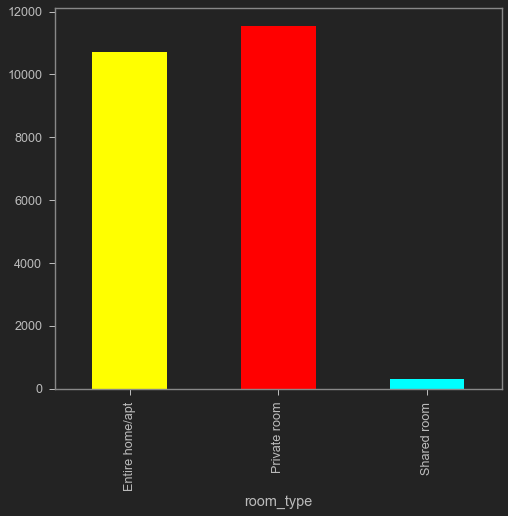

In [19]:
colors = ["yellow", "red", "cyan"]
airbnb_folium.groupby(by="room_type").count().id.plot(kind="bar", color=colors)

In [20]:
berlin = folium.Map(location=[airbnb_lat, airbnb_long], 
                        zoom_start=10)

for i,c in airbnb_folium[['latitude', 'longitude', 'neighbourhood_group_cleansed', 'room_type', 'price']].sample(2222).iterrows():
    label = folium.Popup(f'{i}\n{c["room_type"]}\n{c["price"]:.2f} $')
    if "Entire" in c["room_type"]:
        color = colors[0]
    elif "Private" in c["room_type"]:
        color = colors[1]
    else:
        color = colors[2]
    folium.CircleMarker(
        [c["latitude"], c["longitude"]],
        radius=5,
        popup=label,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        parse_html=False).add_to(berlin)  

berlin

In [21]:
heatmap = folium.Map(location=[airbnb_lat, airbnb_long], zoom_start=10, tiles='Stamen Toner')

# plot heatmap
heatmap.add_child(folium.plugins.HeatMap(airbnb_folium[airbnb_folium.room_type == "Entire home/apt"][['latitude', 'longitude']].values, radius=10))
heatmap

inferences

# Data Presentation
1.Select data
2.Clean data
3.Construct data
4.Integrate data
5.Format

### EDA

[(0.0, 500.0)]

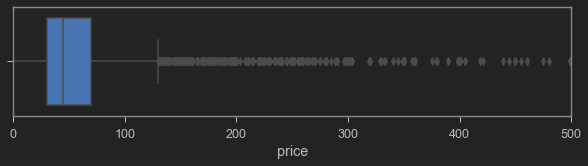

In [22]:
plt.figure(figsize=(10,2))
ax=sns.boxplot(airbnb["price"])
ax.set(xlim=(0, 500))

In [23]:
print("99.5% properties have a price lower than {0: .2f}".format(np.percentile(airbnb["price"], 99.5)))

99.5% properties have a price lower than  400.00


we can see that outliers lie mostly after 400, we place the price more than 0 and less than 2000 for a better analysis

In [24]:
airbnb_new = airbnb[airbnb.price>0]

In [25]:
airbnb_new = airbnb_new[airbnb_new['price']<400]

In [26]:
airbnb_new.shape

(22427, 96)

Let's look at the null values and try to identify the columns of interest

In [27]:
airbnb_na = (airbnb_new.isnull().sum()/len(airbnb_new))*100
airbnb_na[airbnb_na>0].sort_values(ascending=False)

thumbnail_url                  100.000000
host_acceptance_rate           100.000000
jurisdiction_names             100.000000
xl_picture_url                 100.000000
medium_url                     100.000000
square_feet                     98.015785
license                         92.843448
monthly_price                   88.170509
weekly_price                    83.613502
notes                           68.029607
host_response_rate              57.252419
host_response_time              57.247960
interaction                     53.943907
access                          51.892808
host_about                      50.483792
house_rules                     49.293263
neighborhood_overview           48.784947
transit                         42.132251
space                           37.887368
host_neighbourhood              22.535337
review_scores_value             19.498818
review_scores_checkin           19.485442
review_scores_location          19.480983
review_scores_communication     19

In [28]:
airbnb_copy = airbnb_new.copy()

In [29]:
airbnb_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22427 entries, 0 to 22551
Data columns (total 96 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                22427 non-null  int64  
 1   listing_url                       22427 non-null  object 
 2   scrape_id                         22427 non-null  int64  
 3   last_scraped                      22427 non-null  int64  
 4   name                              22369 non-null  object 
 5   summary                           21492 non-null  object 
 6   space                             13930 non-null  object 
 7   description                       22226 non-null  object 
 8   experiences_offered               22427 non-null  object 
 9   neighborhood_overview             11486 non-null  object 
 10  notes                             7170 non-null   object 
 11  transit                           12978 non-null  object 
 12  acce

we can drop the columns that have null values more than 80% 

In [30]:
airbnb_copy = airbnb_copy.drop(columns=['medium_url','jurisdiction_names','thumbnail_url',
                                      'host_acceptance_rate','xl_picture_url','square_feet',
                                      'license','monthly_price','weekly_price'])

we'll replace the in between null values with mean or median

In [31]:
airbnb_copy.price.dtypes

dtype('float64')

In [32]:
for i in airbnb_copy.columns:
    if airbnb_copy[i].dtypes != 'object':
        if (airbnb_copy[i].isna().sum()/len(airbnb_copy))*100 >15:
            airbnb_copy[i] = airbnb_copy[i].fillna(value=airbnb_copy[i].median())


In [33]:
airbnb_na = (airbnb_copy.isnull().sum()/len(airbnb_copy))*100
airbnb_na[airbnb_na>0].sort_values(ascending=False)

notes                        68.029607
host_response_time           57.247960
interaction                  53.943907
access                       51.892808
host_about                   50.483792
house_rules                  49.293263
neighborhood_overview        48.784947
transit                      42.132251
space                        37.887368
host_neighbourhood           22.535337
neighbourhood                 5.025193
summary                       4.169082
zipcode                       2.911669
description                   0.896241
host_location                 0.508316
state                         0.361172
market                        0.280911
name                          0.258617
beds                          0.169439
bathrooms                     0.142685
host_listings_count           0.111473
host_total_listings_count     0.111473
host_has_profile_pic          0.111473
host_identity_verified        0.111473
host_picture_url              0.111473
host_thumbnail_url       

In [34]:
airbnb_copy = airbnb_copy.drop(columns = [ 'id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'summary', 'space',
                                          'experiences_offered', 'neighborhood_overview', 'notes',
                                          'transit', 'access', 'interaction',
                                          'picture_url', 'host_id', 'host_url', 'host_name', 'host_name',
                                          'host_since', 'host_location', 'host_about', 'host_response_time', 'host_response_rate',
                                          'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood',
                                          'host_verifications', 'street','city', 'state', 'zipcode', 'smart_location', 'country_code',
                                          'country', 'latitude', 'longitude', 'neighbourhood', 'neighbourhood_cleansed', 'neighbourhood_group_cleansed',
                                          'property_type', 'room_type', 'amenities', 'calendar_updated', 'cancellation_policy',
                                          'first_review', 'last_review','id','listing_url','house_rules','description',
                                          'market','bed_type','calendar_last_scraped'])


In [35]:
airbnb_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22427 entries, 0 to 22551
Data columns (total 37 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   host_is_superhost                 22402 non-null  object 
 1   host_listings_count               22402 non-null  float64
 2   host_total_listings_count         22402 non-null  float64
 3   host_has_profile_pic              22402 non-null  object 
 4   host_identity_verified            22402 non-null  object 
 5   is_location_exact                 22427 non-null  object 
 6   accommodates                      22427 non-null  int64  
 7   bathrooms                         22395 non-null  float64
 8   bedrooms                          22409 non-null  float64
 9   beds                              22389 non-null  float64
 10  price                             22427 non-null  float64
 11  security_deposit                  22427 non-null  float64
 12  clea

In [36]:
a_list = ['host_is_superhost','host_has_profile_pic','host_identity_verified']
for i in a_list:
    airbnb_copy[i] = airbnb_copy[i].dropna

In [37]:
airbnb_na = (airbnb_copy.isnull().sum()/len(airbnb_copy))*100
airbnb_na[airbnb_na>0].sort_values(ascending=False)

beds                         0.169439
bathrooms                    0.142685
host_listings_count          0.111473
host_total_listings_count    0.111473
bedrooms                     0.080260
dtype: float64

### label encoding

In [38]:
LE = LabelEncoder()

In [39]:
airbnb_list = ['host_is_superhost','host_has_profile_pic','host_identity_verified',
               'has_availability','requires_license','instant_bookable','is_business_travel_ready',
               'require_guest_profile_picture','require_guest_phone_verification','is_location_exact']
for i in airbnb_list:
    airbnb_copy[i] = LE.fit_transform(airbnb_copy[i])

from the pairplot we can see that location, reviews, bathroom, bedrooms and bed may affect the price

### outliers

host_is_superhost


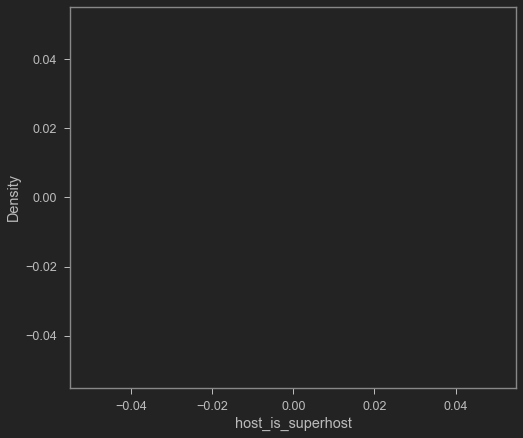

host_listings_count


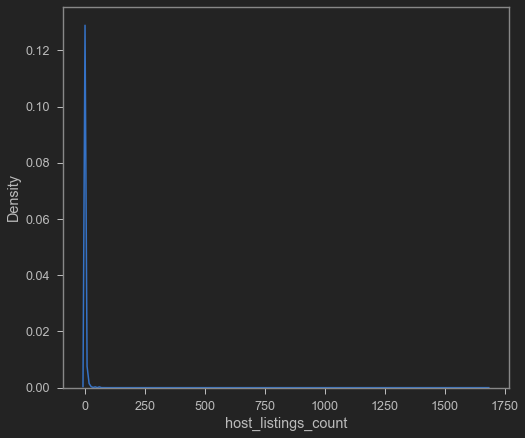

host_total_listings_count


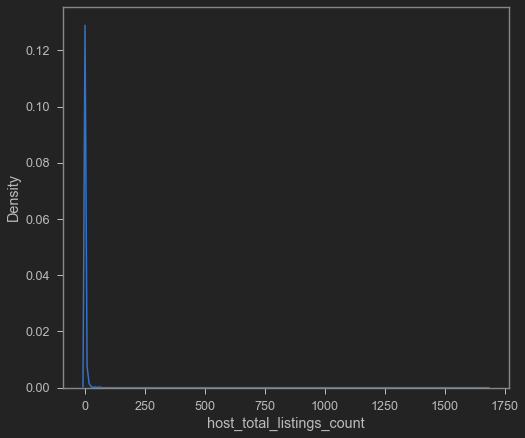

host_has_profile_pic


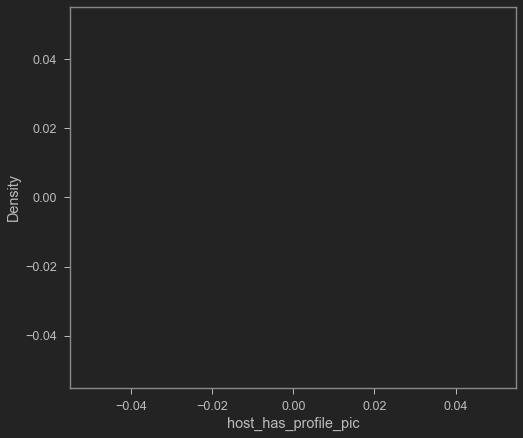

host_identity_verified


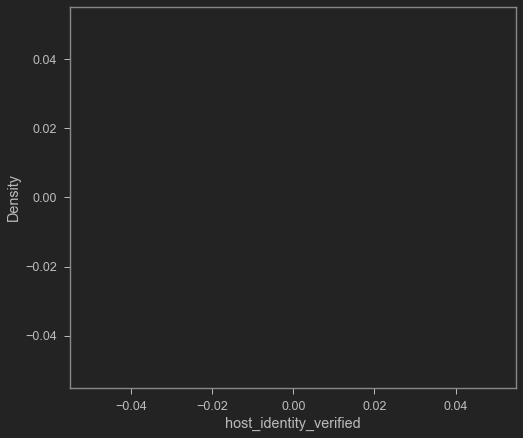

is_location_exact


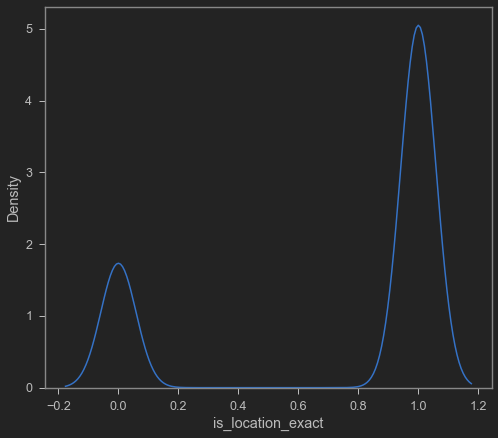

accommodates


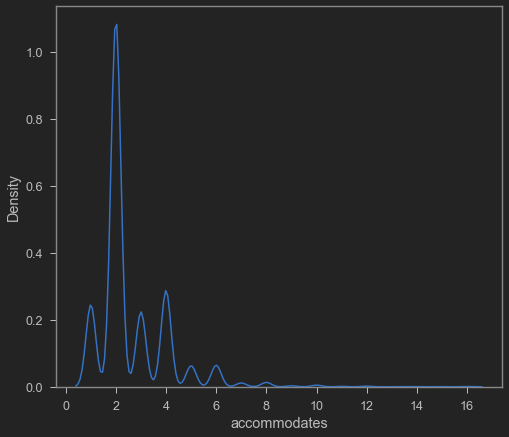

bathrooms


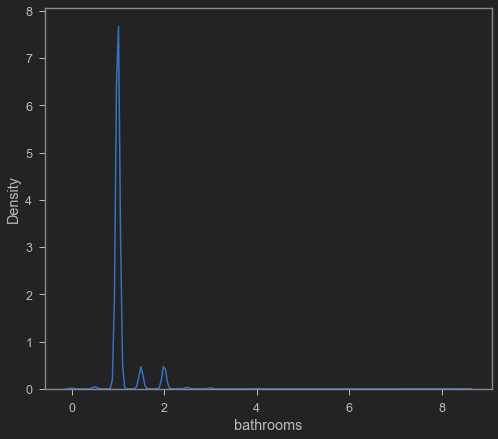

bedrooms


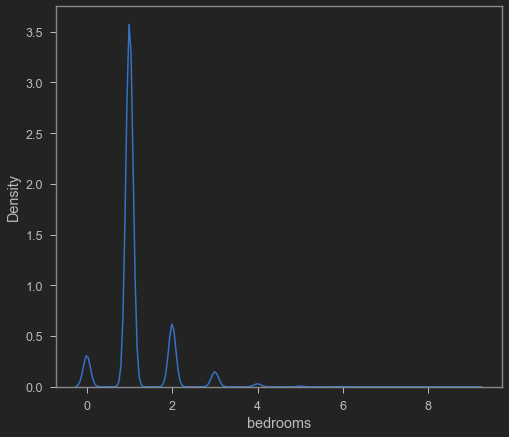

beds


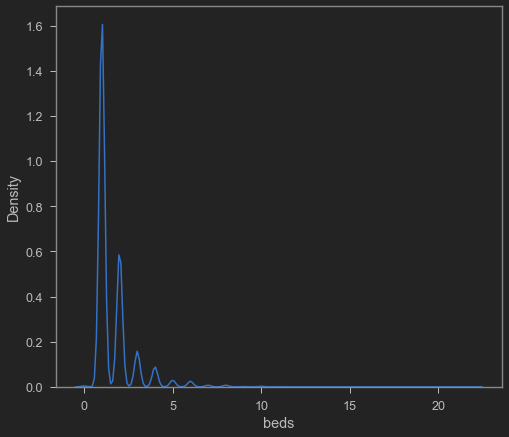

price


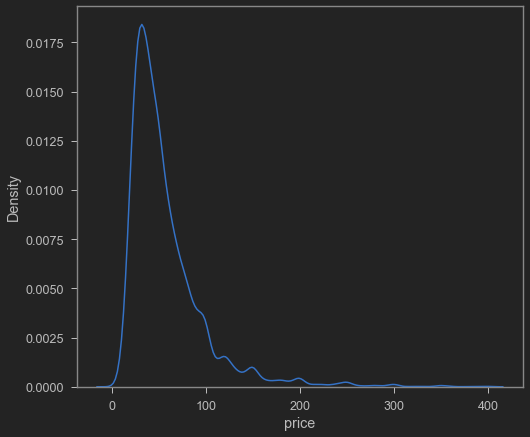

security_deposit


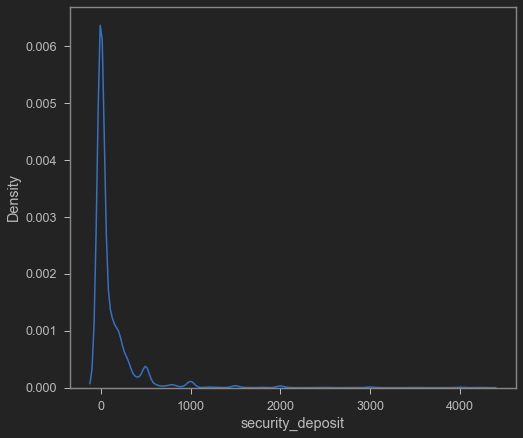

cleaning_fee


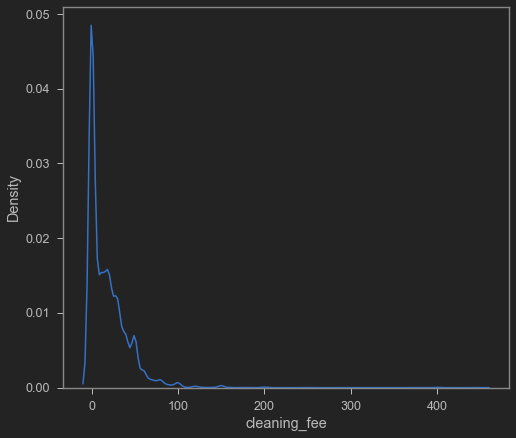

guests_included


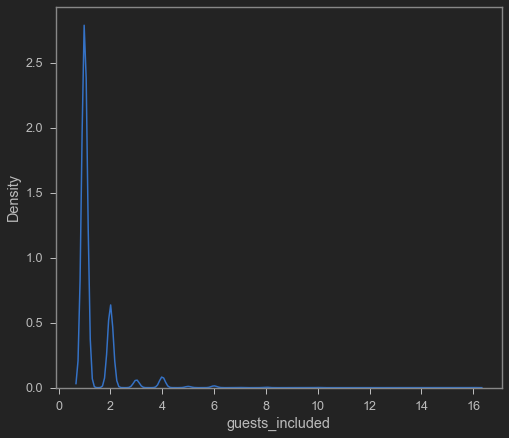

extra_people


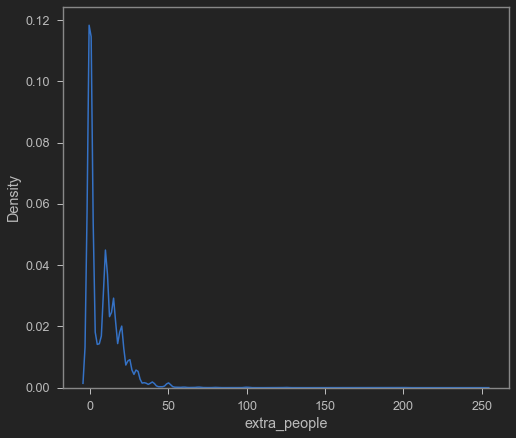

minimum_nights


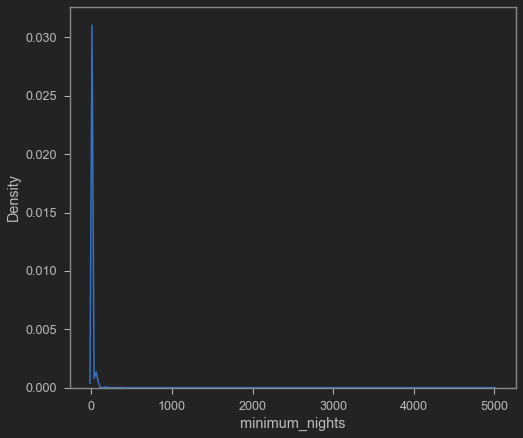

maximum_nights


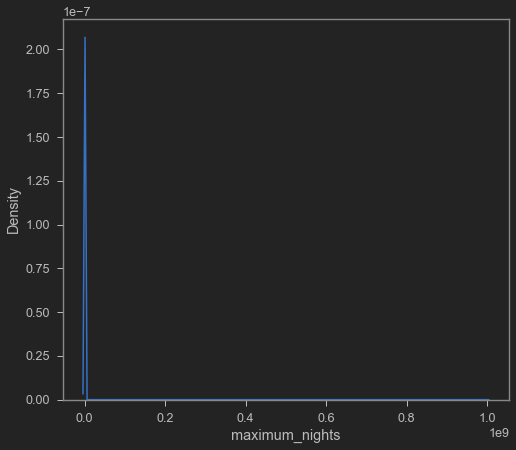

has_availability


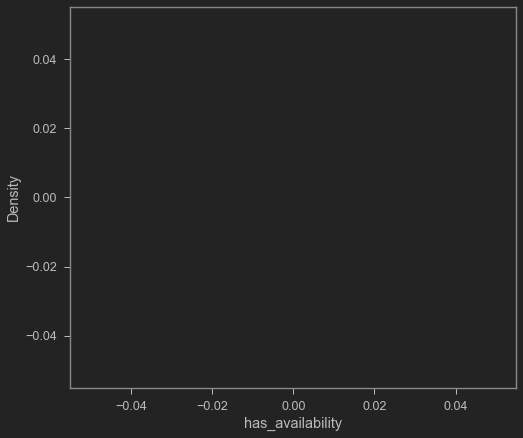

availability_30


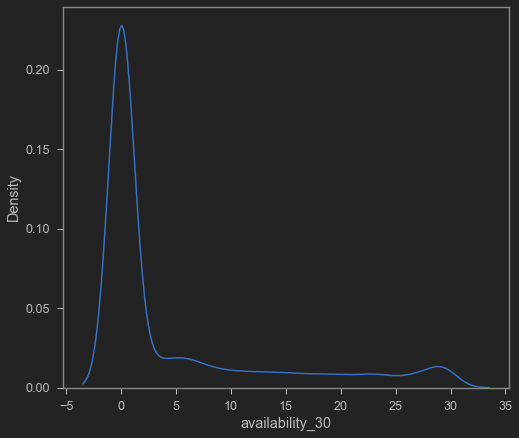

availability_60


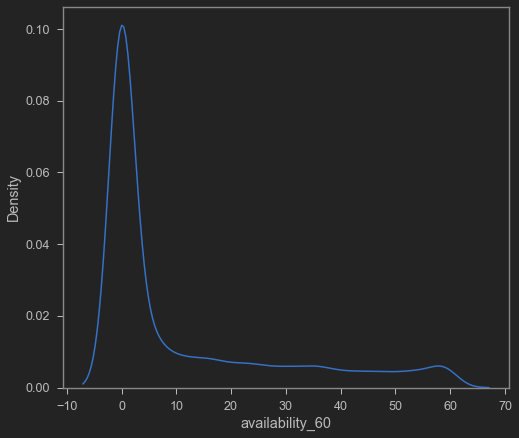

availability_90


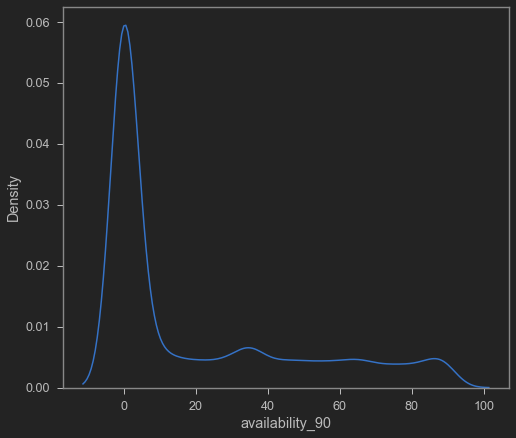

availability_365


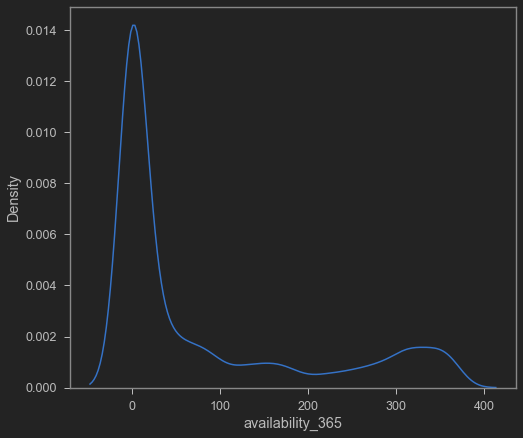

number_of_reviews


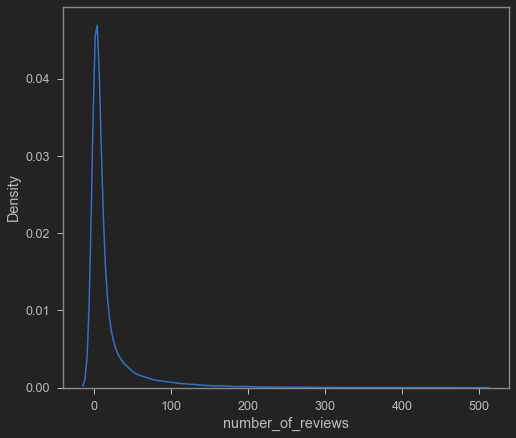

review_scores_rating


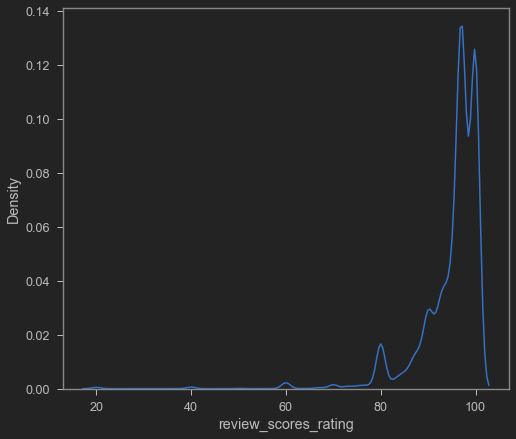

review_scores_accuracy


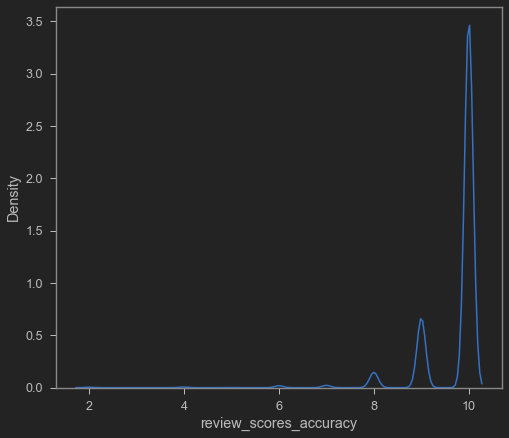

review_scores_cleanliness


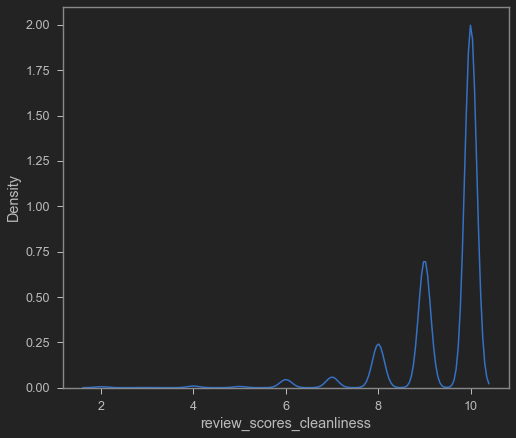

review_scores_checkin


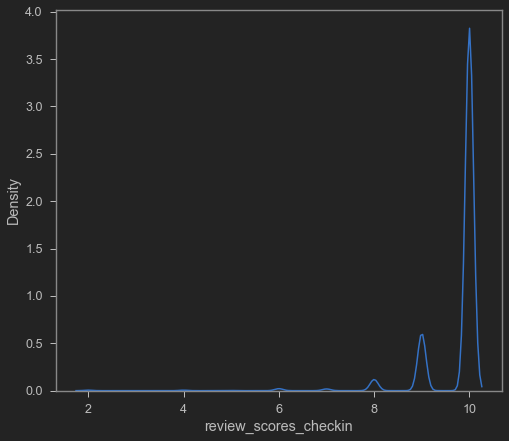

review_scores_communication


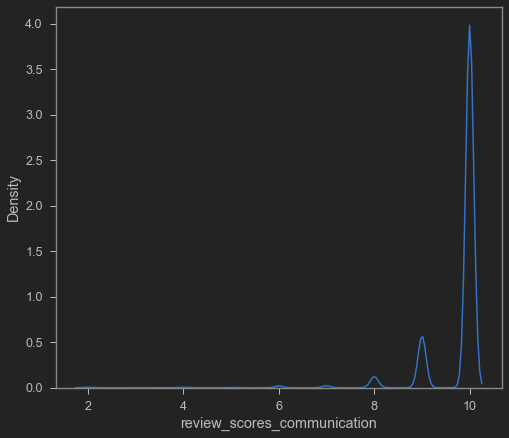

review_scores_location


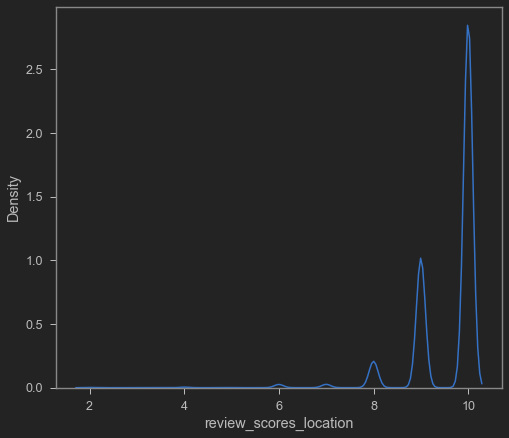

review_scores_value


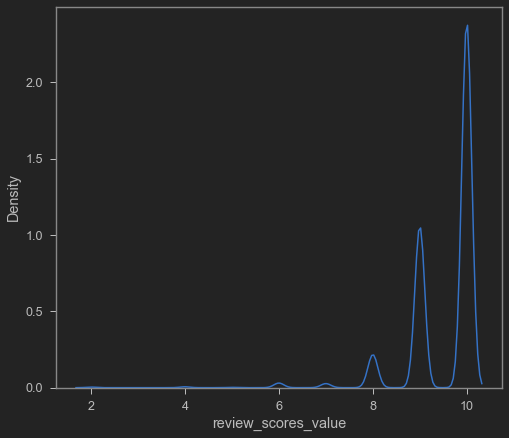

requires_license


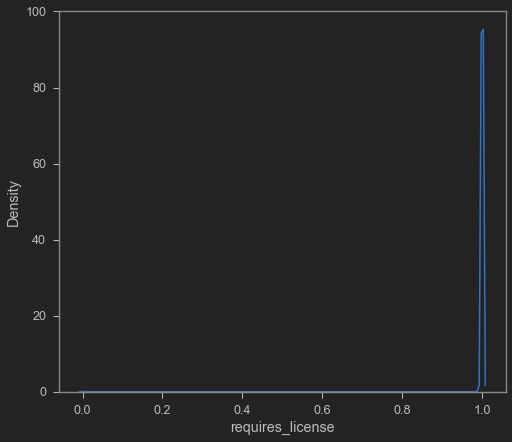

instant_bookable


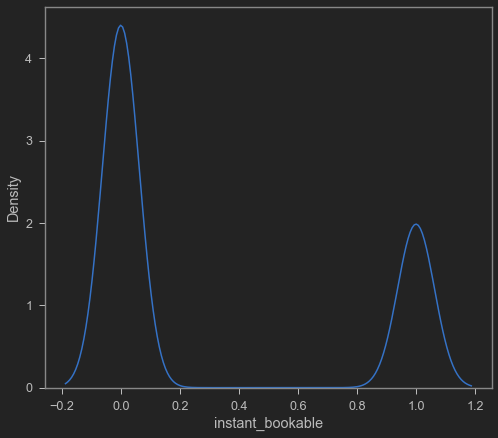

is_business_travel_ready


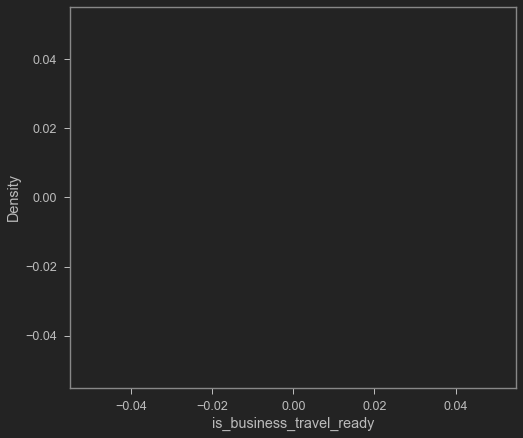

require_guest_profile_picture


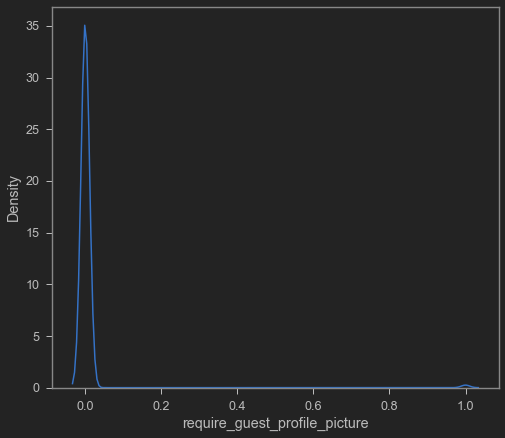

require_guest_phone_verification


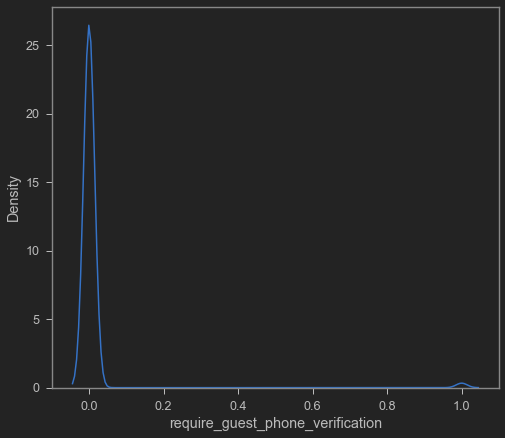

calculated_host_listings_count


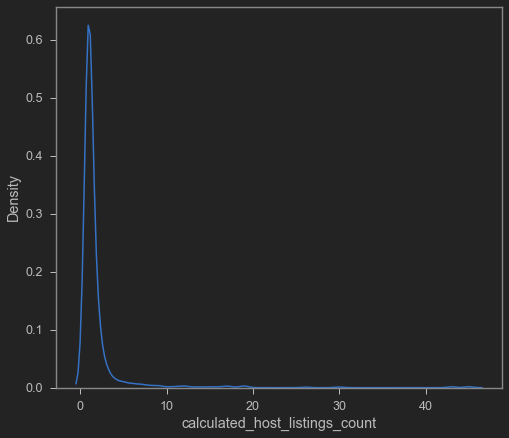

reviews_per_month


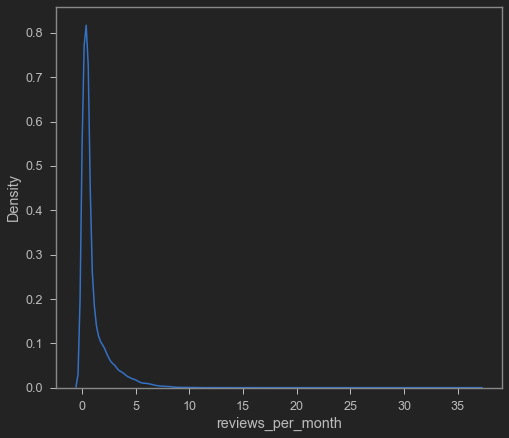

In [40]:
for i in airbnb_copy.columns:
    print(i)
    sns.kdeplot(airbnb_copy[i])
    plt.show()

host_is_superhost


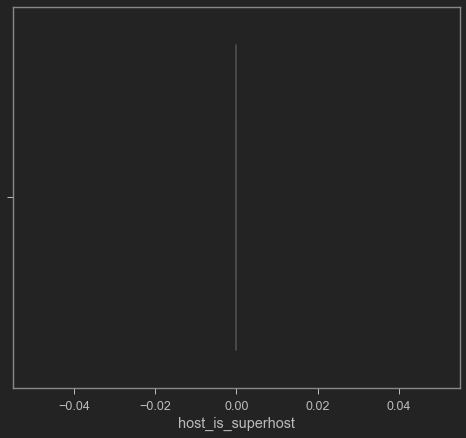

host_listings_count


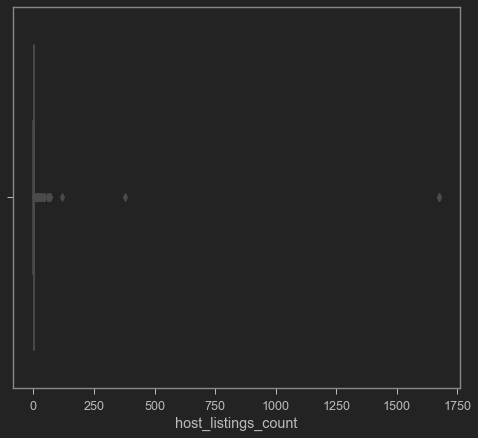

host_total_listings_count


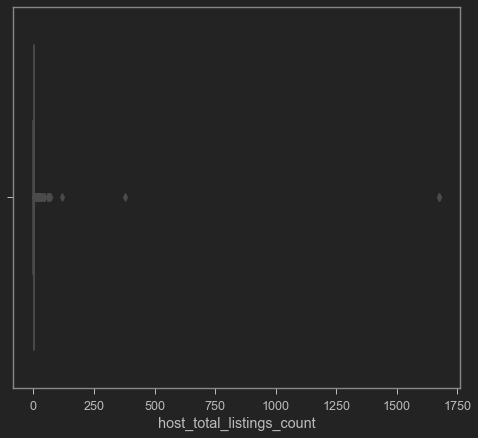

host_has_profile_pic


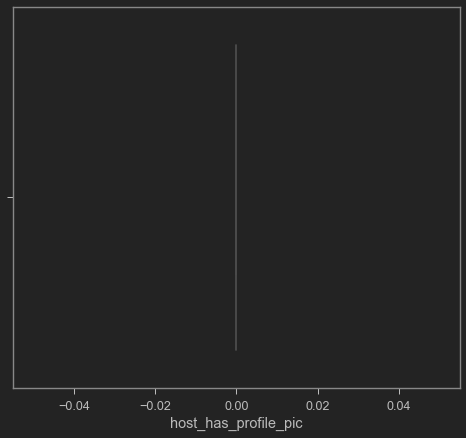

host_identity_verified


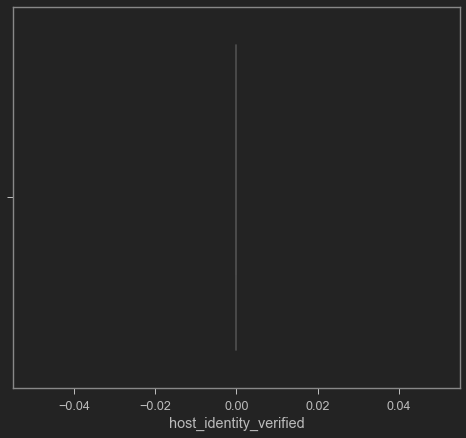

is_location_exact


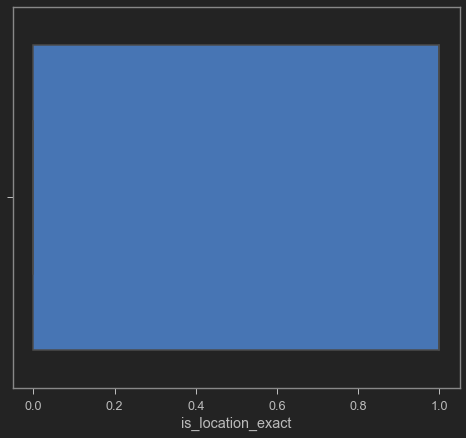

accommodates


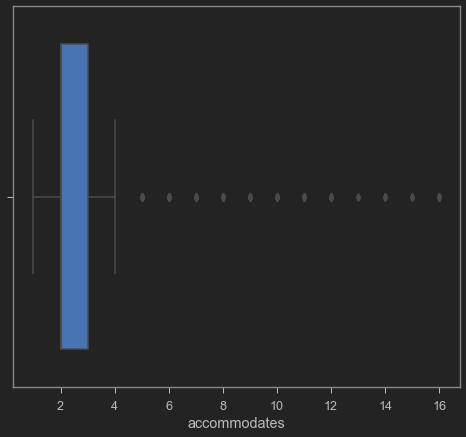

bathrooms


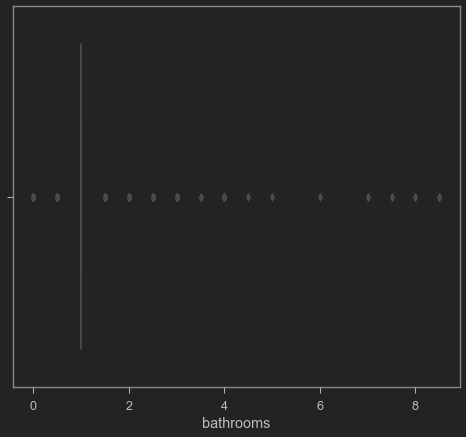

bedrooms


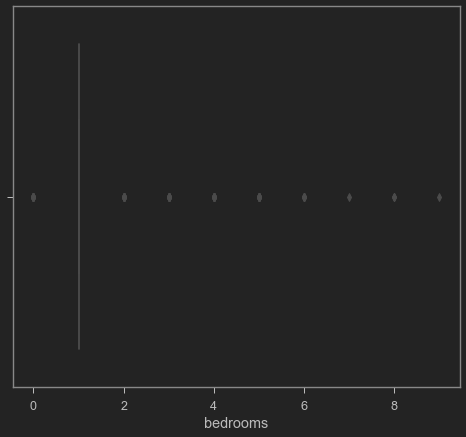

beds


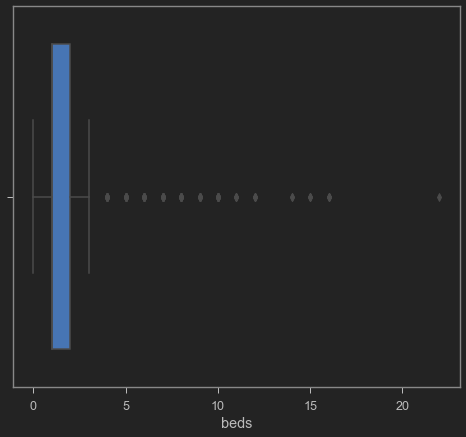

price


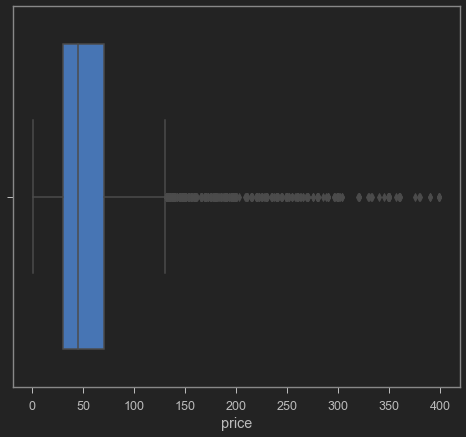

security_deposit


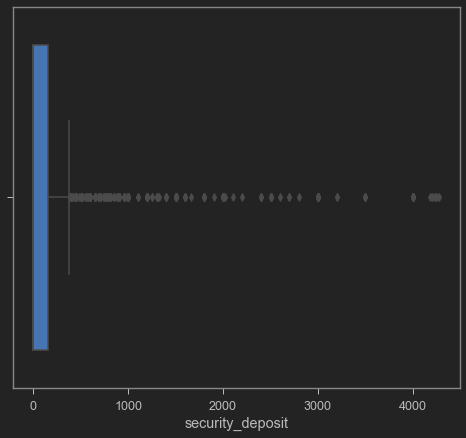

cleaning_fee


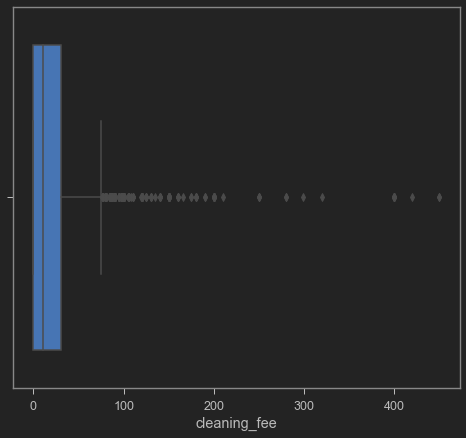

guests_included


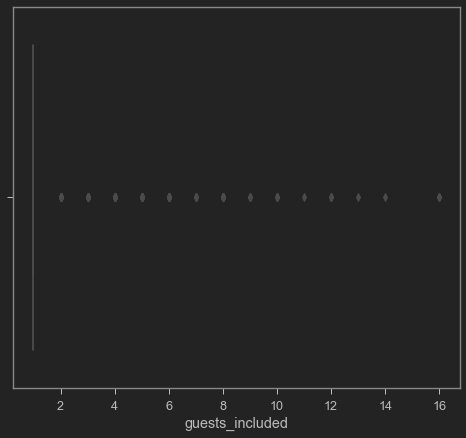

extra_people


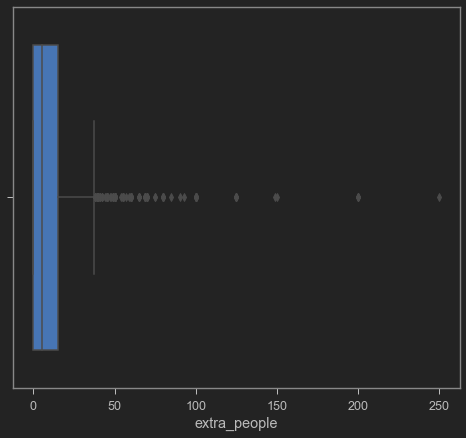

minimum_nights


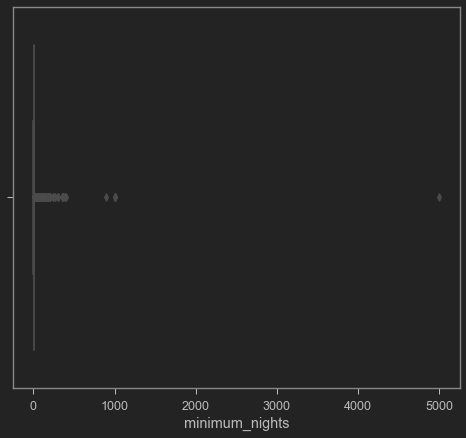

maximum_nights


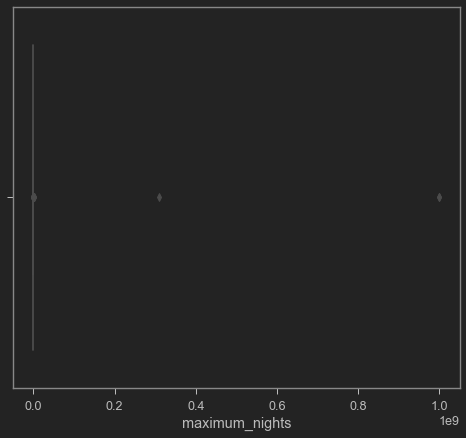

has_availability


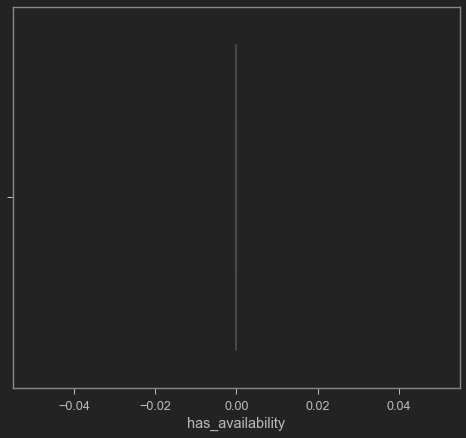

availability_30


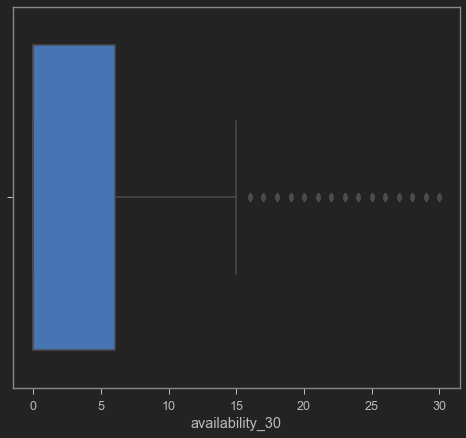

availability_60


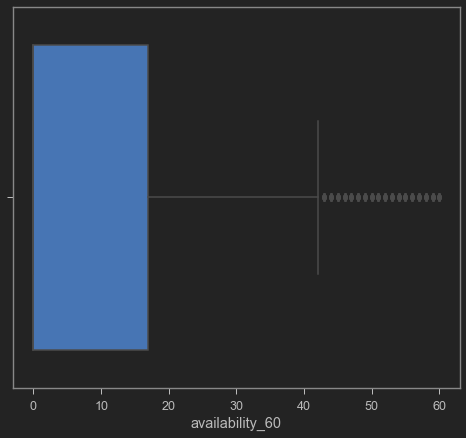

availability_90


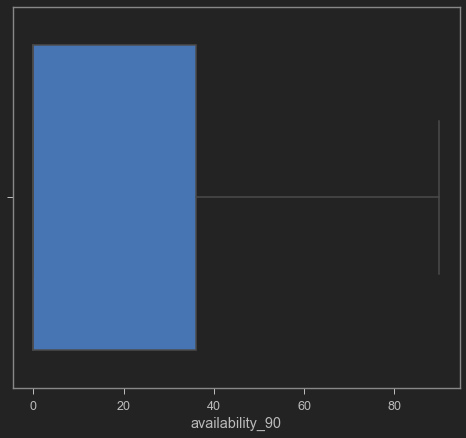

availability_365


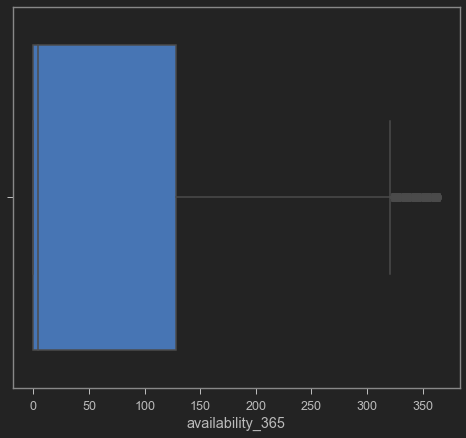

number_of_reviews


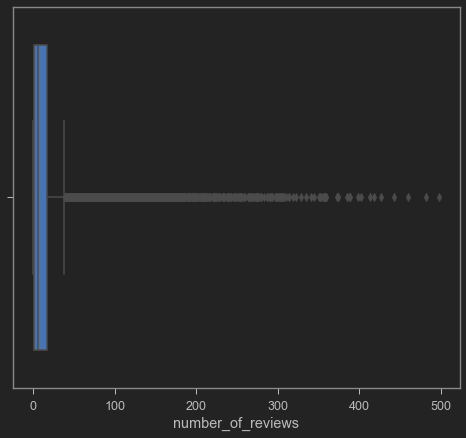

review_scores_rating


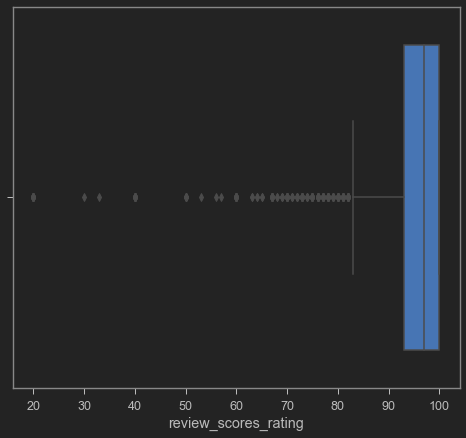

review_scores_accuracy


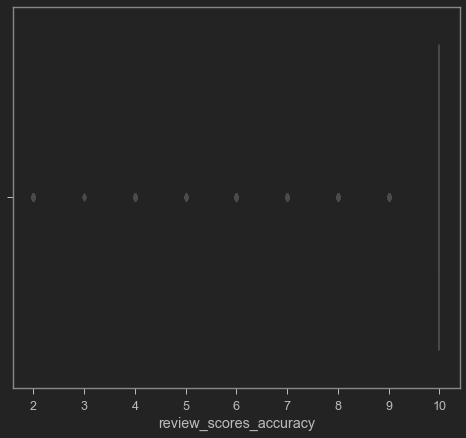

review_scores_cleanliness


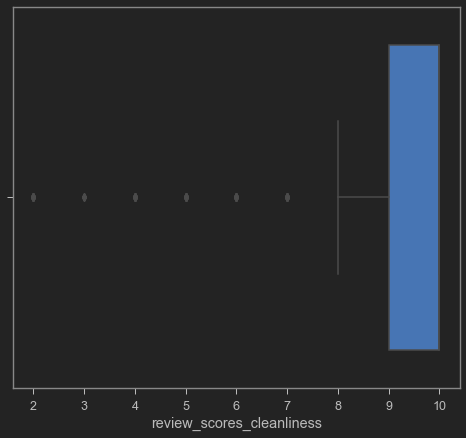

review_scores_checkin


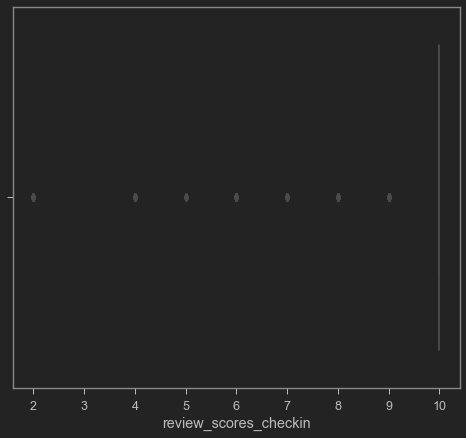

review_scores_communication


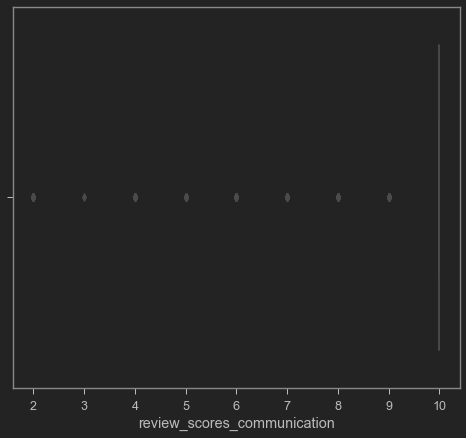

review_scores_location


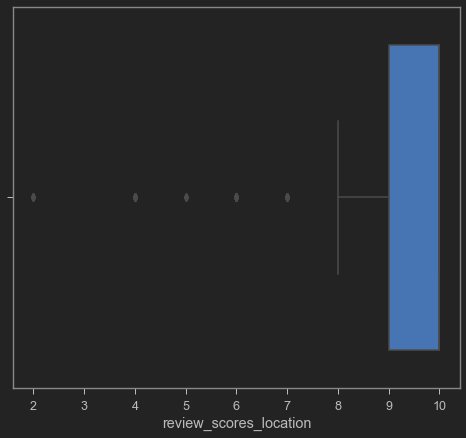

review_scores_value


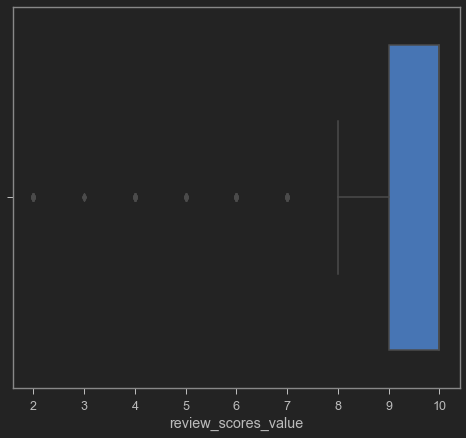

requires_license


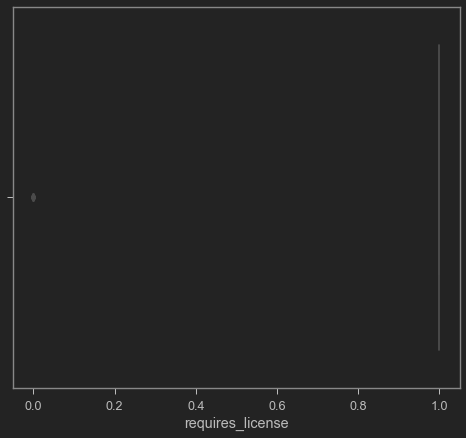

instant_bookable


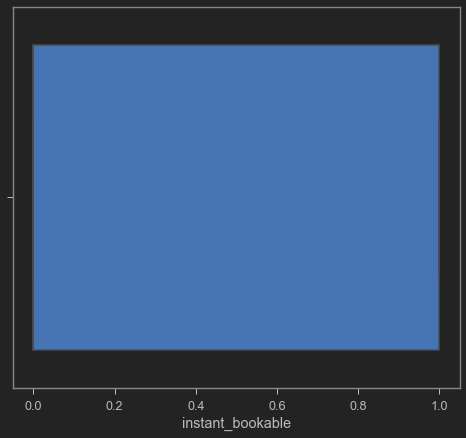

is_business_travel_ready


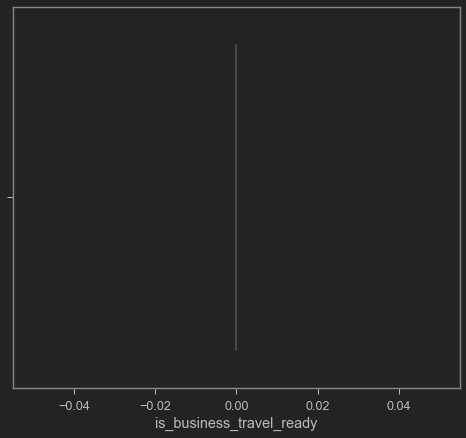

require_guest_profile_picture


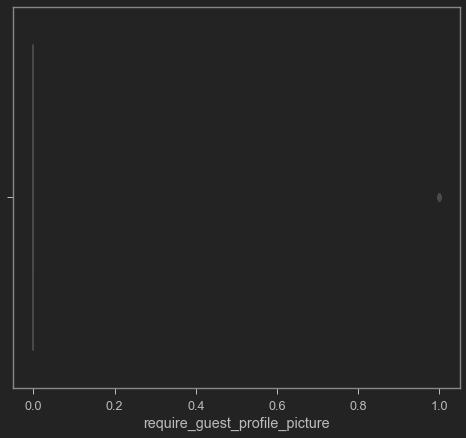

require_guest_phone_verification


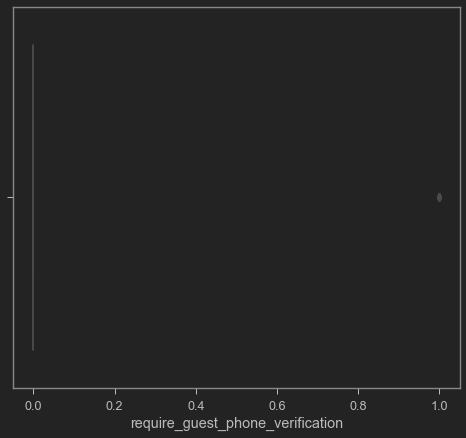

calculated_host_listings_count


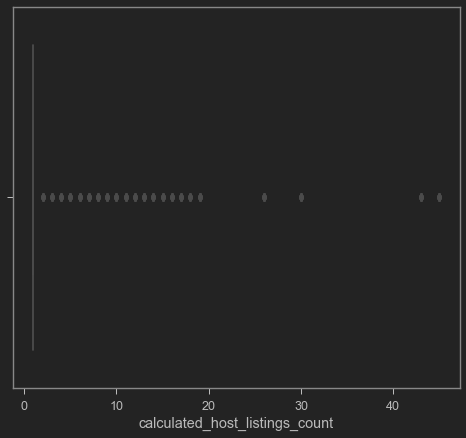

reviews_per_month


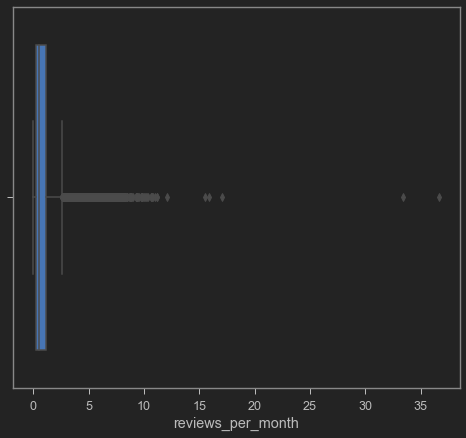

In [41]:
for i in airbnb_copy.columns:
    print(i)
    sns.boxplot(airbnb_copy[i])
    plt.show()

cols = ['host_listings_count','host_total_listings_count','accommodates','bathrooms','bedrooms','beds','price',
        'security_deposit','cleaning_fee','guests_included','extra_people','minimum_nights','maximum_nights',
       'availability_30','availability_60','availability_365','number_of_reviews','review_scores_rating',
       'review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication',
       'review_scores_location','review_scores_value','calculated_host_listings_count','reviews_per_month',
       'reviews_per_month']

Q1 = airbnb_copy[cols].quantile(0.25)
Q3 = airbnb_copy[cols].quantile(0.75)
IQR = Q3 - Q1

airbnb_copy = airbnb_copy[~((airbnb_copy[cols] < (Q1 - 1.5 * IQR)) |(airbnb_copy[cols] > (Q3 + 1.5 * IQR))).any(axis=1)]

after removing the outliers the accuracy reduced to 23% from 44%


### heatmap

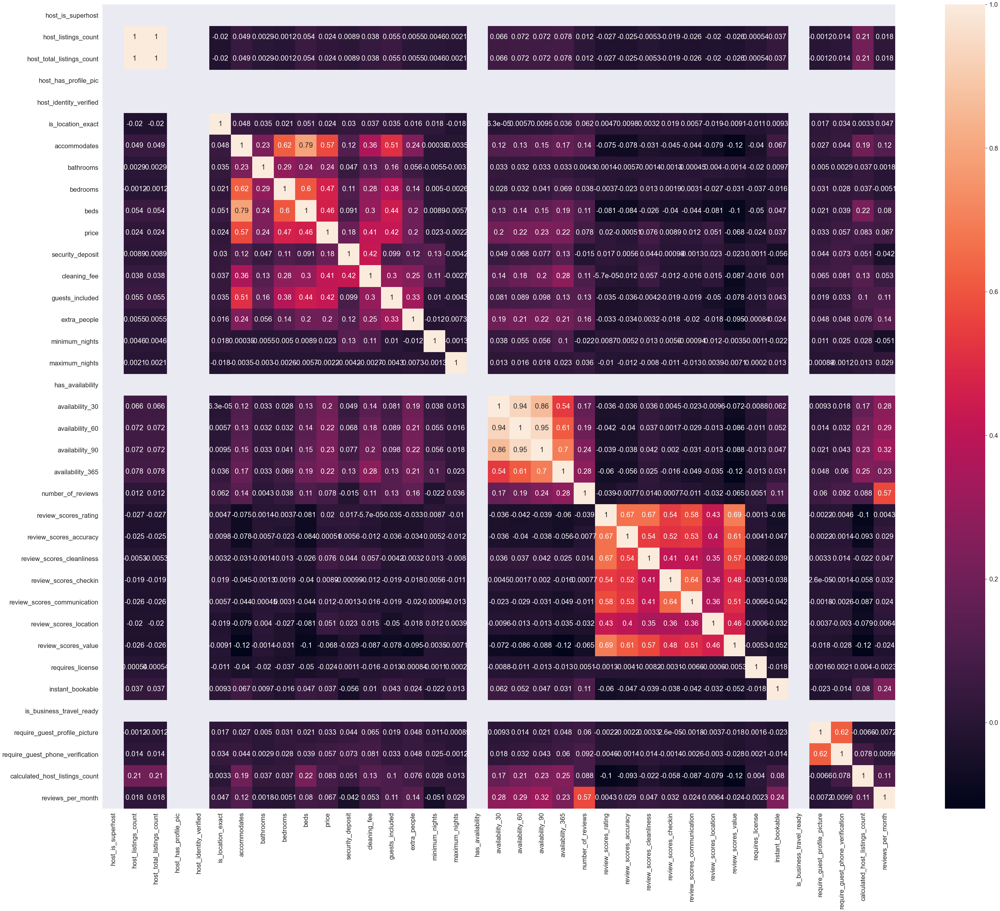

In [42]:
sns.set(font_scale=2)
plt.figure(figsize=(60,50))
sns.heatmap(data=airbnb_copy.corr(), annot=True)
plt.show()

following features are highly correlated

beds - accomodates

availability -365,90,60,30

review_scores_value, review_scores_accuracy, review_scores_rating, review_scores_cleanliness

review_scores_communication- review_scores_checkin

host_listings_count- host_total_listings_count

### convert to code
airbnb_copy = airbnb_copy.drop(columns = [ 'beds','availability_60','availability_90',
                                          'review_scores_value',
                                          'review_scores_accuracy','review_scores_rating','review_scores_communication',
                                          'host_listings_count'])

In [43]:
airbnb_copy = airbnb_copy.drop(columns = ['host_is_superhost','host_has_profile_pic','host_identity_verified',
                                         'has_availability','is_business_travel_ready','bathrooms','bedrooms',
                                         'guests_included','review_scores_accuracy','review_scores_checkin',
                                         'review_scores_communication','calculated_host_listings_count'])  

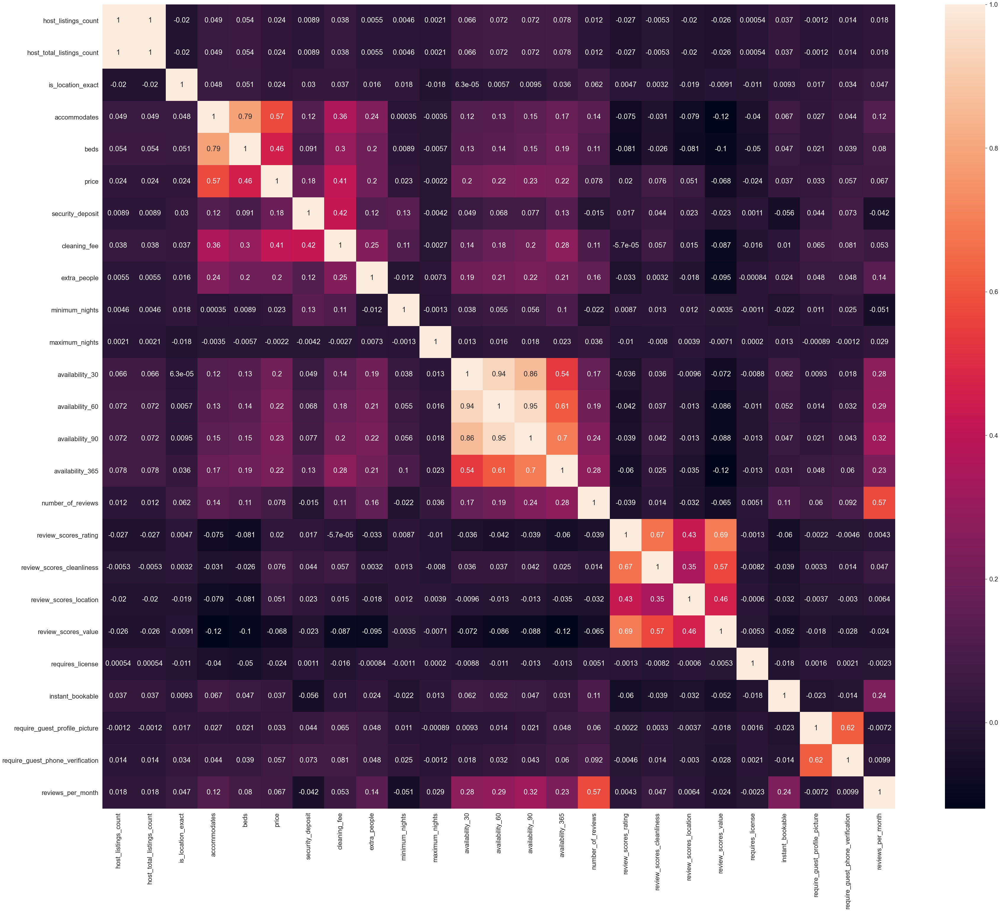

In [44]:
sns.set(font_scale=2)
plt.figure(figsize=(60,50))
sns.heatmap(data=airbnb_copy.corr(), annot=True)
plt.show()

# StandardScaler

In [45]:
from sklearn.preprocessing import StandardScaler
scalar = StandardScaler()
scalar.fit(airbnb_copy)

StandardScaler()

In [46]:
airbnb_na = (airbnb_copy.isnull().sum()/len(airbnb_copy))*100
airbnb_na[airbnb_na>0].sort_values(ascending=False)

beds                         0.169439
host_listings_count          0.111473
host_total_listings_count    0.111473
dtype: float64

In [47]:
airbnb_copy = airbnb_copy.dropna()

In [48]:
airbnb_copy.head()

,host_listings_count,host_total_listings_count,is_location_exact,accommodates,beds,price,security_deposit,cleaning_fee,extra_people,minimum_nights,...,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_location,review_scores_value,requires_license,instant_bookable,require_guest_profile_picture,require_guest_phone_verification,reviews_per_month
0,4.0,4.0,0,3,2.0,60.0,200.0,30.0,28.0,4,...,118,93.0,9.0,10.0,9.0,1,0,0,0,3.76
1,1.0,1.0,1,2,1.0,17.0,0.0,0.0,0.0,2,...,6,100.0,10.0,10.0,10.0,1,0,0,0,1.42
2,1.0,1.0,1,4,2.0,90.0,200.0,50.0,20.0,62,...,143,92.0,9.0,10.0,9.0,1,1,0,0,1.25
3,1.0,1.0,1,2,1.0,26.0,250.0,30.0,18.0,5,...,25,88.0,9.0,9.0,9.0,1,0,0,0,0.39
4,1.0,1.0,1,2,2.0,42.0,0.0,0.0,24.0,2,...,197,96.0,10.0,10.0,9.0,1,0,0,0,1.75


### convert to code

sns.pairplot(data=airbnb_copy)
plt.show()

In [49]:
#sns.pairplot(airbnb_copy.sample(1000))

# Modeling 
1.select the modeling technique.
2.Generate test design
3.Build model
4.Asses the model

building a base model

In [50]:
x = airbnb_copy.drop(columns='price')
y = airbnb_copy['price']

In [51]:
X_train,X_test, y_train, y_test = train_test_split(x,y,test_size=.3)

In [52]:
X_train = sm.add_constant(X_train)

In [53]:
model = sm.OLS(y_train,X_train).fit()

In [54]:
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.414
Model:                            OLS   Adj. R-squared:                  0.413
Method:                 Least Squares   F-statistic:                     480.5
Date:                Sat, 16 Oct 2021   Prob (F-statistic):               0.00
Time:                        11:12:47   Log-Likelihood:                -76227.
No. Observations:               15654   AIC:                         1.525e+05
Df Residuals:                   15630   BIC:                         1.527e+05
Df Model:                          23                                         
Covariance Type:            nonrobust                                         
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const   

In [55]:
#In the table we can see that rsquare and adjusted rsquare are almost near, so lets try to improve our model 
#As our target column is price and it is a continous variable we have used OLS,Gradient Desent
#we have used Backward elimination,Forward selection 

In [56]:
##backward elmination
from mlxtend.feature_selection import SequentialFeatureSelector as sfs
lr=LinearRegression()
lr_bc=sfs(estimator=lr,k_features='best',scoring='r2',forward=False)
sfs_bc=lr_bc.fit(x,y)  # train_test_split(inp,out)
fb=list(sfs_bc.k_feature_names_)
fb

['accommodates',
 'security_deposit',
 'cleaning_fee',
 'extra_people',
 'review_scores_rating',
 'review_scores_cleanliness',
 'review_scores_location',
 'review_scores_value']

In [57]:
#forward selection
lr=LinearRegression()
lr_fs=sfs(estimator=lr,k_features='best',scoring='r2',forward=True)
sfs_fs=lr_fs.fit(x,y)
ff=list(sfs_fs.k_feature_names_)
ff

['accommodates',
 'security_deposit',
 'cleaning_fee',
 'availability_60',
 'review_scores_rating',
 'review_scores_cleanliness',
 'review_scores_location',
 'review_scores_value',
 'reviews_per_month']

In [58]:
#Ada boost to reduce both varience,bias and its a non-random sampling
#from sklearn.ensemble import AdaBoostClassifier
#ada_boost=AdaBoostClassifier()  #try increasing n_estimator=100 or 200
#ada_boost_model = ada_boost.fit(X_train,y_train)
#y_pred=ada_boost_model.predict(X_test)

In [59]:
#from sklearn.metrics import classification_report,confusion_matrix,roc_auc_score,roc_curve
#print(classification_report(y_test,y_pred))
#cm=confusion_matrix(y_test,y_pred)

In [60]:
import seaborn as sns
#sns.heatmap(cm,annot=True)

In [61]:
from sklearn.model_selection import GridSearchCV
#param = [{'n_estimator':[10,20,30,40,50,60,90,100],'learning_rate':[0.1,0.5,1]}]

#adaboost_grid =GridSearchCV(estimator ='ada_boost',param_grid=param,cv=5)
#adaboost_grid_model=adaboost_grid.fit(X_train,y_train)
#adaboost_grid_model.best_params_

In [62]:
#ada=AdaBoostClassifier(n_estimator=10,learning_rate=0.1)
#ada_model=ada.fit(x_train,y_test)
#y_pred=ada_model.predict(x_test)
#cm=confusion_matrix(y_test,y_pred)
#cm

We tried to implement AdaBoost to reduce both bias and variance and to check non-random sampling, due to uncertanity it did not worked for us.

### Ridge and lasso

In [63]:
from sklearn.linear_model import LinearRegression

In [64]:
linreg = LinearRegression()

In [65]:
X_train,X_test, y_train, y_test = train_test_split(x,y,test_size=.3)

In [66]:
linreg.fit(X_train, y_train)

LinearRegression()

In [67]:
print ("train score:", (linreg.score(X_train,y_train)))
print ("test score:", (linreg.score(X_test,y_test)))


train score: 0.4188981671770863
test score: 0.38883270788625046


In [68]:
y_pred = linreg.predict(X_test)

In [69]:
ridge = Ridge(alpha=1.09)
ridge.fit(X_train,y_train)
print ("Ridge model:", (ridge.coef_))
print ("train score:", (ridge.score(X_train,y_train)))
print ("test score:", (ridge.score(X_test,y_test)))

Ridge model: [-1.57420682e-02 -1.57420682e-02 -3.15322198e-01  1.39873565e+01
  2.78156076e-01  3.09561763e-03  3.07205077e-01  5.66192645e-03
 -3.95176994e-03 -4.15666919e-09  9.55452475e-02  1.34912003e-01
  7.16487136e-02  5.09124712e-03 -2.80461535e-02  2.46284665e-01
  2.95370993e+00  5.01479829e+00 -4.50981138e+00 -1.73045965e+01
  1.09203077e+00 -1.52294788e+00  3.91314716e+00 -1.24689095e+00]
train score: 0.41889544751038377
test score: 0.3889416878187527


In [70]:
lasso = Lasso(alpha=0)
lasso.fit(X_train,y_train)
print ("Lasso model:", (lasso.coef_))


Lasso model: [-3.14679887e-02  3.92519507e-15 -3.16808447e-01  1.39877270e+01
  2.73381113e-01  3.09798581e-03  3.07184582e-01  5.78207188e-03
 -3.94789243e-03 -4.16088630e-09  9.54397671e-02  1.34993803e-01
  7.16208769e-02  5.07968512e-03 -2.80318516e-02  2.46323265e-01
  2.95404539e+00  5.01523758e+00 -4.51209236e+00 -2.11031998e+01
  1.09075135e+00 -1.57329196e+00  3.96013251e+00 -1.24648568e+00]


In [71]:
print ("train score:", (lasso.score(X_train,y_train)))
print ("test score:", (lasso.score(X_test,y_test)))

train score: 0.4188981671770863
test score: 0.3888327078862487


In [72]:
#generating polynomial features

from sklearn.preprocessing import PolynomialFeatures
poly = PolynomialFeatures(degree=2, interaction_only=True)
X_poly = poly.fit_transform(x)
this reduced the accuracy of the model

In [73]:
#
from sklearn.feature_selection import RFE,RFECV
lr=LinearRegression()
rfe=RFE(estimator=lr,n_features_to_select=5)
rfe_mod=rfe.fit(X_train,y_train)

In [74]:
rfe_mod.ranking_

array([15, 13,  8,  1,  9, 19,  6, 16, 18, 20, 11,  7, 12, 17, 14, 10,  2,
        1,  1,  1,  5,  4,  1,  3])

In [75]:
X_train.columns

Index(['host_listings_count', 'host_total_listings_count', 'is_location_exact',
       'accommodates', 'beds', 'security_deposit', 'cleaning_fee',
       'extra_people', 'minimum_nights', 'maximum_nights', 'availability_30',
       'availability_60', 'availability_90', 'availability_365',
       'number_of_reviews', 'review_scores_rating',
       'review_scores_cleanliness', 'review_scores_location',
       'review_scores_value', 'requires_license', 'instant_bookable',
       'require_guest_profile_picture', 'require_guest_phone_verification',
       'reviews_per_month'],
      dtype='object')

In [76]:
rank=pd.DataFrame()
rank['Feature']=X_train.columns
rank['RANK']=rfe_mod.ranking_
#print(rank)
rfe_feat=list(rank[rank['RANK']==1]['Feature'])
rfe_feat

['accommodates',
 'review_scores_location',
 'review_scores_value',
 'requires_license',
 'require_guest_phone_verification']

In [77]:
x_rfe = pd.DataFrame(airbnb_copy,columns=['is_location_exact',
 'accommodates',
 'requires_license',
 'instant_bookable',
 'require_guest_phone_verification'])
y_rfe = airbnb_copy['price']

In [78]:
X_train,X_test, y_train, y_test = train_test_split(x_rfe,y_rfe,test_size=.3)
linreg.fit(X_train, y_train)

LinearRegression()

In [79]:
print ("train score:", (linreg.score(X_train,y_train)))
print ("test score:", (linreg.score(X_test,y_test)))


train score: 0.33457144570953246
test score: 0.3276184172460692


In [80]:
LinearRegression()

LinearRegression()

grid search 

In [81]:
from sklearn.model_selection import GridSearchCV
tuned_paramaters = [{'alpha':np.arange(0,5,.01)}]
ridge = Ridge()

ridge_grid = GridSearchCV(estimator = ridge, 
                          param_grid = tuned_paramaters, 
                          cv = 10)
ridge_grid.fit(X_train, y_train)

print('Best parameters for Ridge Regression: ', ridge_grid.best_params_, '\n')


Best parameters for Ridge Regression:  {'alpha': 4.99} 



In [82]:
from sklearn.linear_model import Lasso

tuned_paramaters = [{'alpha':[7, 8, 9, 10, 11]}]

lasso = Lasso()


lasso_grid = GridSearchCV(estimator = lasso, 
                          param_grid = tuned_paramaters, 
                          cv = 10)
lasso_grid.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=Lasso(),
             param_grid=[{'alpha': [7, 8, 9, 10, 11]}])

In [83]:
lasso_grid.best_params_

{'alpha': 7}

# Conclusion
Using LinearRegression our R2 and adjusted r2 is 41.70 percent,we tried to improvised our model by using ridge and lasso where in our r2 and adjusted r2 was rapidly decreasing so, we conclude that basic model worked well with 42% of accuracy.


'accommodates','security_deposit','cleaning_fee','availability_60','review_scores_rating','review_scores_cleanliness',
'review_scores_location','review_scores_value','reviews_per_month'

Using Forward selection the  above features affected our target column.
By this we can tell that the feature above has improvised AirBnb Accomodation services w.r.t to price.